In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.utils import to_categorical
import numpy as np
from tensorflow.keras.models import Sequential
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix
import plotly.graph_objects as go
from tensorflow.keras.layers import GRU, Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
import time
import pickle

In [2]:
df = pd.read_csv('Dataset/Dataset.csv')
df

,RMS,MAV,WL,ZC,MDF,MNF,MNP,SSC,IMDF,IMPF,PSD,stft_feature_1,stft_feature_2,stft_feature_3,stft_feature_4,stft_feature_5,stft_feature_6,Label
0,0.022736,0.022627,0.292123,0,0.000000,2.197170,0.000003,116,30.257109,30.937241,3.073555e-09,13.696220,1.940833,10.605068,61.017445,13.818565,43.017377,0
1,0.022575,0.022451,0.292784,0,0.000000,1.840327,0.000003,113,33.923486,34.813665,7.078425e-09,9.980477,2.204785,10.249872,44.328669,15.324474,45.580027,0
2,0.022946,0.022778,0.331666,0,0.000000,1.983257,0.000003,112,29.465366,29.028470,7.134970e-09,9.971431,2.213371,10.445191,41.194637,15.666418,44.280514,0
3,0.022771,0.022658,0.310395,0,0.000000,1.997399,0.000003,117,30.508609,31.878987,5.664619e-09,11.048052,2.165253,10.263955,44.136258,15.086787,42.423923,0
4,0.022656,0.022554,0.287916,0,0.000000,2.147299,0.000003,112,32.230025,33.754340,4.352106e-09,10.581928,2.132273,13.098369,44.357848,15.341267,52.083661,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59503,0.086811,0.062074,2.998200,6,29.296875,40.761364,0.000026,60,41.915116,42.507696,1.816313e-06,66.563291,42.825503,49.092941,30.466052,33.978844,45.109856,3
59504,0.069848,0.045826,1.968011,6,25.390625,40.761364,0.000017,73,33.054052,34.365584,7.578535e-06,47.237738,49.908652,13.689787,35.244638,29.855072,51.018355,3
59505,0.031229,0.023963,0.801592,4,13.671875,40.761364,0.000004,82,31.109326,33.625658,4.365286e-08,74.153174,5.318532,10.511970,78.039440,23.974134,42.957928,3
59506,0.019134,0.018792,0.344580,0,0.000000,40.761364,0.000002,97,39.108328,39.230273,7.985387e-09,15.214164,2.773115,10.477527,52.840586,18.701360,44.276793,3


In [3]:
# Analyze label distribution
label_counts = df['Label'].value_counts()
print("Label Distribution:\n", label_counts)

Label Distribution:
 Label
1    16663
2    16023
3    15820
0    11002
Name: count, dtype: int64


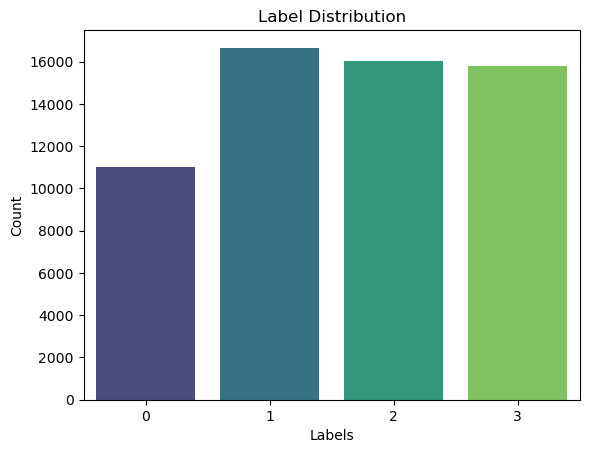

In [4]:
# Plot label distribution with seaborn
sns.countplot(x='Label', data=df, palette='viridis')
plt.title('Label Distribution')
plt.xlabel('Labels')
plt.ylabel('Count')
plt.show()


In [5]:
df1 = df.drop(columns=['Label'])

In [7]:
# Create a subplot for each column in the DataFrame
fig = go.Figure()
for column in df1.columns:
    fig.add_trace(go.Histogram(x=df1[column], name=column))

# Update layout
fig.update_layout(
    title='Distribution of X_train before scaling',
    xaxis_title='Value',
    yaxis_title='Frequency',
    barmode='overlay'  # Overlay histograms for better visualization
)

# Show the plot
fig.show()


In [9]:
# Create figure
fig = go.Figure()

# Plot non Fatigue data
fig.add_trace(go.Scatter(x=df[df['Label'] == 0].index, y=df[df['Label'] == 0]['MNF'], mode='lines', name="Resting"))

# Plot Transition to Fatigue data
fig.add_trace(go.Scatter(x=df[df['Label'] == 1].index, y=df[df['Label'] == 1]['MNF'], mode='lines', name="No strain"))

# Plot Transition to Fatigue data
fig.add_trace(go.Scatter(x=df[df['Label'] == 2].index, y=df[df['Label'] == 2]['MNF'], mode='lines', name="medium strain"))

# Plot Fatigue data
fig.add_trace(go.Scatter(x=df[df['Label'] == 3].index, y=df[df['Label'] == 3]['MNF'], mode='lines', name="max strain"))



# Update layout
fig.update_layout(
    title="ARV Raw Signal",
    xaxis_title="Time",
    yaxis_title="Amplitude"
)

# Show plot
fig.show()


In [10]:
feature_columns = ['RMS', 'MAV', 'WL', 'SSC', 'MDF', 'MNF', 'MNP', 'PSD', 'stft_feature_1', 'stft_feature_2', 'stft_feature_3']
Label_column = ['Label']

In [11]:
# Split the DataFrame into features (X) and target (y)
X = df[feature_columns]
Y = df[Label_column]  # Replace 'target_column' with the name of your target column


In [12]:
X.shape

(59508, 13)

In [13]:
# Scale the features using StandardScaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [14]:
timesteps = 30
num_features = X_scaled.shape[1]

data_segments = {f'X{j}': [] for j in range(num_features)}  # Dictionary to store segments for each feature
y = []  # List to store labels

# Segment the data from df
for i in range(0, X.shape[0] - timesteps):
    for j in range(num_features):  # Loop for column indexing
        data_segments[f'X{j}'].append(X.iloc[i:i + timesteps, j].values)

# Segment the labels from labels_df
for i in range(0, Y.shape[0] - timesteps):
    y.append(Y.iloc[i + timesteps, 0])  # Assuming the label to predict is the last one in the window


In [15]:
y_encoded= to_categorical(y, num_classes=4)

In [16]:
# Convert lists in data_segments to NumPy arrays for easier manipulation
X_segments = np.array([np.array(data_segments[f'X{j}']) for j in range(num_features)])
X_segments = np.swapaxes(X_segments, 0, 1)  # Swap axes to get the shape (samples, timesteps, features)
X_segments = np.swapaxes(X_segments, 1, 2)  # Final shape: (samples, timesteps, features)

# Convert labels list to a NumPy array
Y = np.array(y)

# Splitting the data into training and test sets
X_train, X_test, Y_train, Y_test = train_test_split(X_segments, Y, test_size=0.2, random_state=42,stratify=Y)


In [17]:
X_train.shape

(47582, 30, 13)

In [19]:
# Assuming X_train.shape = (num_samples, sequence_length, num_features)
num_classes = 4  # Number of output classes

model_gru = Sequential([
    GRU(128, input_shape=(X_train.shape[1], X_train.shape[2])),
    Dropout(0.5),
    Dense(128, activation='relu'),
    Dense(num_classes, activation='softmax')  # Output layer for multi-class classification
])

optimizer = Adam(learning_rate=0.0001)
model_gru.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])

print(model_gru.summary())


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru_1 (GRU)                 (None, 128)               54912     
                                                                 
 dropout_1 (Dropout)         (None, 128)               0         
                                                                 
 dense_2 (Dense)             (None, 128)               16512     
                                                                 
 dense_3 (Dense)             (None, 4)                 516       
                                                                 
Total params: 71940 (281.02 KB)
Trainable params: 71940 (281.02 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
None


In [21]:
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)
# Learning rate reduction to reduce the learning rate when validation loss plateaus
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=0.001)


In [22]:
history = model_gru.fit(X_train, Y_train, epochs=200, batch_size=32, validation_split=0.1,callbacks=[early_stopping,reduce_lr])

Epoch 1/200


1339/1339 [==============================] - 21s 14ms/step - loss: 0.8625 - accuracy: 0.5129 - val_loss: 0.8353 - val_accuracy: 0.6077 - lr: 1.0000e-04
Epoch 2/200
1339/1339 [==============================] - 20s 15ms/step - loss: 0.7894 - accuracy: 0.5521 - val_loss: 0.8273 - val_accuracy: 0.6054 - lr: 1.0000e-04
Epoch 3/200
1339/1339 [==============================] - 21s 16ms/step - loss: 0.7764 - accuracy: 0.5676 - val_loss: 0.8198 - val_accuracy: 0.6071 - lr: 1.0000e-04
Epoch 4/200
1339/1339 [==============================] - 21s 16ms/step - loss: 0.7655 - accuracy: 0.5754 - val_loss: 0.8063 - val_accuracy: 0.6188 - lr: 1.0000e-04
Epoch 5/200
1339/1339 [==============================] - 21s 16ms/step - loss: 0.7549 - accuracy: 0.5846 - val_loss: 0.7864 - val_accuracy: 0.6258 - lr: 1.0000e-04
Epoch 6/200
1339/1339 [==============================] - 21s 16ms/step - loss: 0.7438 - accuracy: 0.5938 - val_loss: 0.7732 - val_accuracy: 0.6325 - lr: 1.0000e-04
Epoch 7/200
13

In [23]:
# Evaluate the model on the test set
y_pred = model_gru.predict(X_test)
y_pred_classes = np.argmax(y_pred, axis=1)  # Convert softmax output to class labels


372/372 [==============================] - 3s 5ms/step


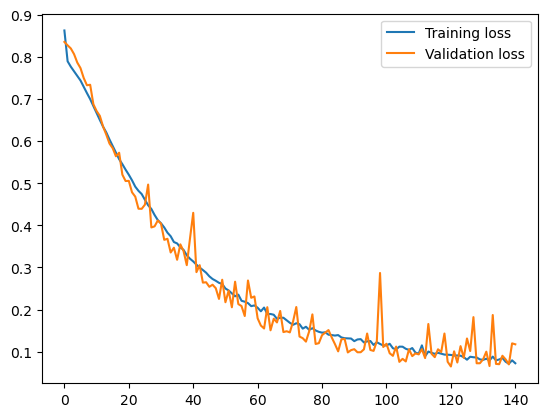

In [24]:
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.legend()

In [26]:
# Calculate test accuracy
test_accuracy = accuracy_score(Y_test, y_pred_classes)
print("Test Accuracy:", test_accuracy)

Test Accuracy: 0.9783960995292535


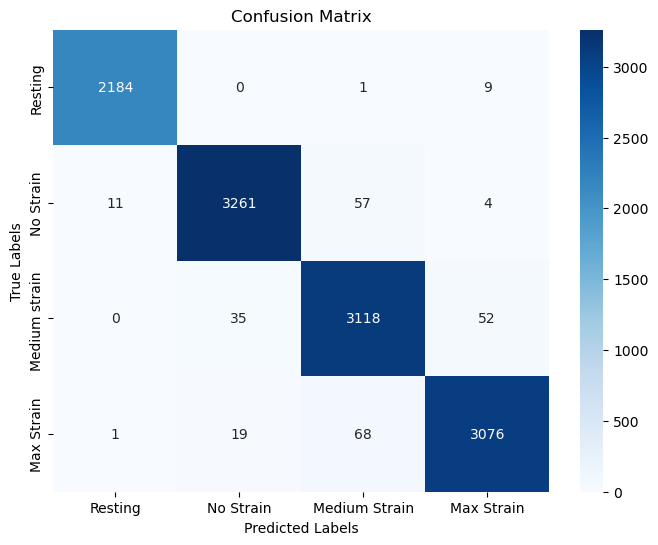

In [27]:
# Generate confusion matrix
conf_matrix = confusion_matrix(Y_test, y_pred_classes)

# Plot confusion matrix as heatmap using Seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Resting', 'No Strain','Medium Strain','Max Strain'], yticklabels=['Resting', 'No Strain','Medium strain ','Max Strain'])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

In [28]:
start_time = time.time()

X_train_pred = model_gru.predict(X_test)
# End the timer
end_time = time.time()

# Calculate the inference time
inference_time = end_time - start_time
print("Inference time:", inference_time)

372/372 [==============================] - 2s 6ms/step
Inference time: 2.4263603687286377


In [29]:
model_gru.save('GRU.keras')

In [28]:
# Save the scaler to a file
with open('scaler.pkl', 'wb') as file:
    pickle.dump(scaler, file)

print("Scaler has been saved as 'scaler.pkl'")

Scaler has been saved as 'scaler.pkl'
